## AirBnB Analysis
<i> Summary of the AirBnB data - to be filled in once below complete </i>

Sources used for code below: 
<br> https://medium.com/@stella96joshua/how-to-combine-multiple-csv-files-using-python-for-your-analysis-a88017c6ff9e
<br> https://chat.openai.com

## Setup

In [1]:
# Dependencies and Setup
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import hvplot.pandas
import scipy.stats as st
from config import geoapify_key

# Read 2020 and 2023 AirBnB Data Files and store into Pandas DataFrames
AirBnB_2020_data = pd.read_csv("../AirBnB Analysis/resources/AB_US_2020.csv")
AirBnB_2023_data = pd.read_csv("../AirBnB Analysis/resources/AB_US_2023.csv")


In [2]:
#Clean data for AirBnb 2020 - delete unneeded data
del AirBnB_2020_data["host_name"]
del AirBnB_2020_data["neighbourhood_group"]
del AirBnB_2020_data["host_id"]
del AirBnB_2020_data["neighbourhood"]
del AirBnB_2020_data["calculated_host_listings_count"]
del AirBnB_2020_data["last_review"]
AirBnB_2020_data.head()

,year,id,name,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,city
0,2020,38585,Charming Victorian home - twin beds + breakfast,35.65146,-82.62792,Private room,60,1,138,1.14,0,Asheville
1,2020,80905,French Chic Loft,35.59779,-82.55540,Entire home/apt,470,1,114,1.03,288,Asheville
2,2020,108061,Walk to stores/parks/downtown. Fenced yard/Pet...,35.60670,-82.55563,Entire home/apt,75,30,89,0.81,298,Asheville
3,2020,155305,Cottage! BonPaul + Sharky's Hostel,35.57864,-82.59578,Entire home/apt,90,1,267,2.39,0,Asheville
4,2020,160594,Historic Grove Park,35.61442,-82.54127,Private room,125,30,58,0.52,0,Asheville


In [3]:
#Clean data for AirBnb 2023 - delete unneeded data
del AirBnB_2023_data["host_name"]
del AirBnB_2023_data["neighbourhood_group"]
del AirBnB_2023_data["host_id"]
del AirBnB_2023_data["neighbourhood"]
del AirBnB_2023_data["calculated_host_listings_count"]
del AirBnB_2023_data["last_review"]
del AirBnB_2023_data["number_of_reviews_ltm"]
AirBnB_2023_data.head()

,year,id,name,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,city
0,2023,958.0,"Bright, Modern Garden Unit - 1BR/1BTH",37.77028,-122.43317,Entire home/apt,202,2,383,2.31,128,San Francisco
1,2023,5858.0,Creative Sanctuary,37.74474,-122.42089,Entire home/apt,235,30,111,0.66,365,San Francisco
2,2023,8142.0,Friendly Room Apt. Style -UCSF/USF - San Franc...,37.76555,-122.45213,Private room,56,32,9,0.09,365,San Francisco
3,2023,8339.0,Historic Alamo Square Victorian,37.77564,-122.43642,Entire home/apt,575,9,28,0.17,365,San Francisco
4,2023,8739.0,"Mission Sunshine, with Private Bath",37.76030,-122.42197,Private room,110,1,770,4.65,159,San Francisco


In [4]:
AirBnB_2020_count = AirBnB_2020_data["id"].nunique()
AirBnB_2020_count

226029

In [5]:
AirBnB_2023_count = AirBnB_2023_data["id"].nunique()
AirBnB_2023_count

215468

In [6]:
# Combine the data into a single dataset using left join
# Used ChatGPT & Google Source to help with code below 
AirBnB_data_complete = pd.concat([AirBnB_2020_data, AirBnB_2023_data], ignore_index=False)
AirBnB_data_complete


,year,id,name,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,city
0,2020,3.858500e+04,Charming Victorian home - twin beds + breakfast,35.651460,-82.627920,Private room,60,1,138,1.14,0,Asheville
1,2020,8.090500e+04,French Chic Loft,35.597790,-82.555400,Entire home/apt,470,1,114,1.03,288,Asheville
2,2020,1.080610e+05,Walk to stores/parks/downtown. Fenced yard/Pet...,35.606700,-82.555630,Entire home/apt,75,30,89,0.81,298,Asheville
3,2020,1.553050e+05,Cottage! BonPaul + Sharky's Hostel,35.578640,-82.595780,Entire home/apt,90,1,267,2.39,0,Asheville
4,2020,1.605940e+05,Historic Grove Park,35.614420,-82.541270,Private room,125,30,58,0.52,0,Asheville
...,...,...,...,...,...,...,...,...,...,...,...,...
232142,2023,8.492300e+17,Private Half Moon Bay Oasis By Pillar Point Be...,37.506164,-122.476188,Entire home/apt,389,2,0,NaN,365,San Mateo County
232143,2023,8.508050e+17,Home near SFO,37.623630,-122.426570,Entire home/apt,158,1,0,NaN,364,San Mateo County
232144,2023,8.515620e+17,Modern New Private Studio in SFO,37.655661,-122.413130,Entire home/apt,97,1,0,NaN,359,San Mateo County
232145,2023,8.517930e+17,Lux Bedroom with a Shared Bath near SFO,37.644792,-122.454213,Private room,62,2,0,NaN,67,San Mateo County


## Customer Demand Summary - 2020

For the purposes of this analysis, popularity is determined by the % availability and expensive by avg. price per city 
- Analyze most popular Top 10 cities in U.S. = low mean availability (i.e., low mean indicates AirBnB was rented and NOT available) in 2020
- Analyze least popular Bottom 10 cities in U.S. = high % availability (i.e., high mean indicates AirBnB was NOT rented and therefore available) in 2020
- Analyze most expensive Top 10 cities in U.S. = top 10 cities with highest avg. prices of AirBnB per city in 2020
- Analyze least expensive Bottom 10 cities in U.S. =  bottom 10 cities with highest avg. prices of AirBnB per city in 2020


In [7]:
# Calculate the total number of unique AirBnBs grouped by City
Total_AirBnBs_2020 = AirBnB_2020_data.groupby("city").size().sort_values(ascending=False)
Total_AirBnBs_2020

city
New York City        45756
Los Angeles          31536
Hawaii               22434
San Diego            12404
Broward County       10858
Austin               10436
Clark County          8408
Washington D.C.       7350
San Clara Country     7091
San Francisco         7053
Seattle               6575
Twin Cities MSA       6470
New Orleans           6408
Chicago               6397
Nashville             6139
Portland              4281
Denver                4200
Rhode Island          3884
Boston                3339
Oakland               3204
San Mateo County      2855
Jersey City           2488
Asheville             2074
Santa Cruz County     1571
Columbus              1409
Cambridge             1029
Salem                  202
Pacific Grove          179
dtype: int64

In [43]:
map_plot_2020= AirBnB_2020_data.hvplot.points("longitude",
                                              "latitude",
                                              geo=True,
                                              tiles="OSM",
                                              frame_width=700,
                                              frame_height=400,
                                              size="availability",
                                              scale=0.4,
                                              color="city")
display(map_plot_2020)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]   (city)

In [44]:
# Group the data by city and calculate the average availability per AirBnB
popularity_2020 = AirBnB_2020_data.groupby("city")["availability_365"].mean().round(1)
popularity_2020_percent = (popularity_2020 / 365) *100

#Display Most Popular Cities (i.e., Top 10) with lowest mean of availability
popularity_2020_top = popularity_2020.sort_values(ascending=True).head(10)
popularity_2020_top


city
Oakland            115.0
New York City      120.7
Twin Cities MSA    126.3
Seattle            126.4
Denver             128.1
Austin             133.5
Cambridge          134.9
Washington D.C.    140.2
San Diego          143.3
Rhode Island       146.4
Name: availability_365, dtype: float64

In [45]:
#Display Least Popular Cities (i.e., Bottom 10) with highest % availability
popularity_2020_bottom = popularity_2020.sort_values(ascending=False).head(10)
popularity_2020_bottom

city
Hawaii            223.9
Broward County    199.0
Clark County      185.5
Nashville         185.2
Boston            184.5
Jersey City       183.8
Pacific Grove     179.7
New Orleans       175.2
Chicago           174.3
Los Angeles       173.8
Name: availability_365, dtype: float64

In [177]:
popularity_2020_percent


city
Oakland              31.506849
New York City        33.068493
Twin Cities MSA      34.602740
Seattle              34.630137
Denver               35.095890
Austin               36.575342
Cambridge            36.958904
Washington D.C.      38.410959
San Diego            39.260274
Rhode Island         40.109589
Portland             41.452055
Santa Cruz County    41.698630
Columbus             42.054795
Salem                42.520548
Asheville            44.739726
San Francisco        45.068493
San Clara Country    46.027397
San Mateo County     47.342466
Los Angeles          47.616438
Chicago              47.753425
New Orleans          48.000000
Pacific Grove        49.232877
Jersey City          50.356164
Boston               50.547945
Nashville            50.739726
Clark County         50.821918
Broward County       54.520548
Hawaii               61.342466
Name: availability_365, dtype: float64

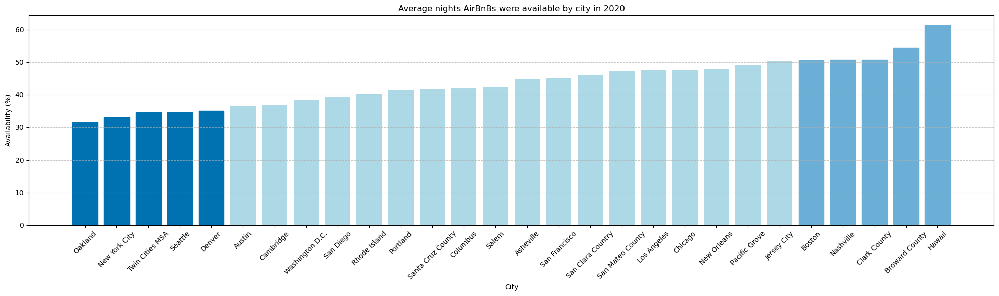

In [178]:
# Define different shades of blue for different groups
top5_blue = '#0072B2'
bottom5_blue = '#6BAED6'
other_blue = '#ADD8E6'

# Assuming popularity_2020_percent is a pandas Series
# Sort the data in ascending order
popularity_2020_percent = popularity_2020_percent.sort_values(ascending=True)

# Plot bar graph showing the average % availability of AirBnBs by city
plt.figure(figsize=(20, 6))
bars = plt.bar(popularity_2020_percent.index, popularity_2020_percent, color=other_blue)

# Set color for top 5 and bottom 5 cities
for i, bar in enumerate(bars):
    if i < 5:
        bar.set_color(top5_blue)
    elif i >= len(bars) - 5:
        bar.set_color(bottom5_blue)

plt.title("Average nights AirBnBs were available by city in 2020")
plt.xlabel("City")
plt.ylabel("Availability (%)")
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.yticks(range(0, 61, 10))  # Set y-axis ticks from 0 to 100 with a step of 10
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add horizontal grid lines
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

In [179]:
#Calculate avg. price per AirBnB grouped by City
average_price_per_city_2020=AirBnB_2020_data.groupby(["city"])["price"].mean().round(1)

#Display Most Expensive Cities (i.e., Top 10 highest avg. price of AirBnB)
average_price_per_city_2020.sort_values(ascending=False).head(10)

city
Twin Cities MSA      509.9
Columbus             321.7
San Diego            318.8
Hawaii               309.1
Rhode Island         288.7
Austin               269.3
Santa Cruz County    257.1
San Francisco        252.0
Pacific Grove        251.1
Salem                247.7
Name: price, dtype: float64

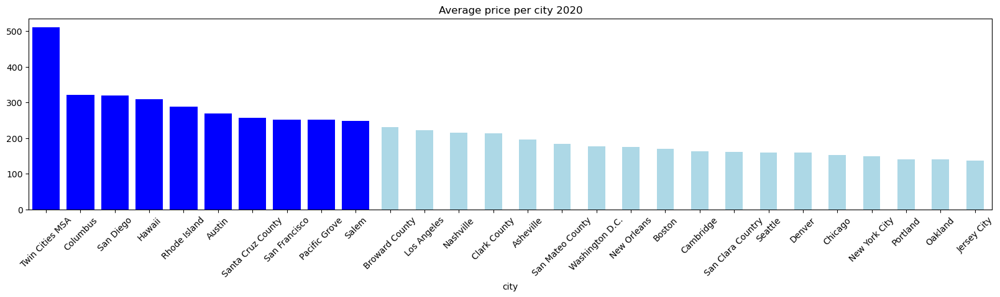

In [245]:
# Sort the data in ascending order
average_price_per_city_2020_sorted = average_price_per_city_2020.sort_values(ascending=False)

# Plot bar graph showing the average price of AirBnBs by city
plt.figure(figsize=(20, 4))
ax = average_price_per_city_2020_sorted.plot(kind="bar", color="lightblue") 
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Color the top 10 bars differently
top_10_cities = average_price_per_city_2020_sorted.nlargest(10)
for city in top_10_cities.index:
    ax.bar(city, top_10_cities[city], color="blue")  # Color the top 10 bars with blue color


plt.title("Average price per city 2020")
plt.show()

In [246]:
#Display Least Expensive Cities (i.e., Bottom 10 lowest avg. price of AirBnB)
average_price_per_city_2020.sort_values(ascending=True).head(10)/round(1)

city
Jersey City          137.0
Oakland              140.0
Portland             141.0
New York City        149.6
Chicago              153.0
Denver               158.9
Seattle              159.7
San Clara Country    161.7
Cambridge            163.1
Boston               170.3
Name: price, dtype: float64

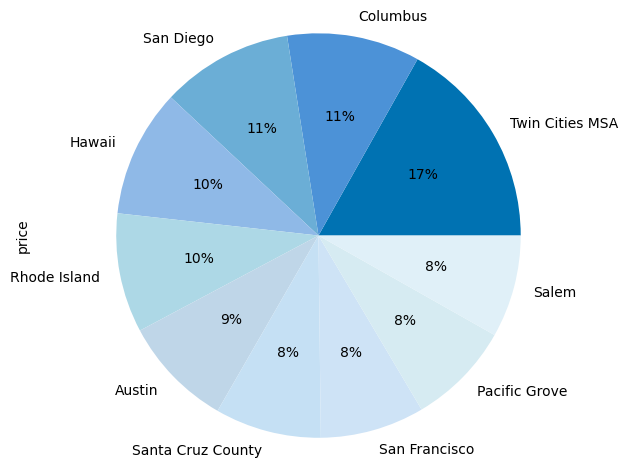

In [247]:
# Define different shades of blue
shades_of_blue = ['#0072B2', '#4C92D7', '#6BAED6', '#8FB9E7', '#ADD8E6', '#BFD6E8', '#C5E0F4', '#CEE3F6', '#D6EBF2', '#E0F0F8']

# Plot the pie chart with shades of blue
top_10_cities.plot(kind="pie", autopct="%1.0f%%", shadow=False, startangle=0, colors=shades_of_blue)

plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.tight_layout()
plt.show()

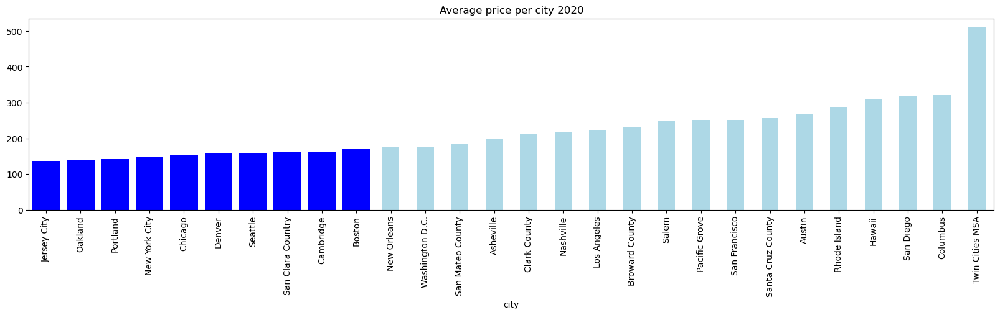

In [248]:
# Sort the data in ascending order
average_price_per_city_2020_sorted = average_price_per_city_2020.sort_values(ascending=True)

# Plot bar graph showing the average price of AirBnBs by city
plt.figure(figsize=(20, 4))
ax = average_price_per_city_2020_sorted.plot(kind="bar", color="lightblue")

# Plot bottom 10 bars separately to change their color
bottom_10_cities = average_price_per_city_2020_sorted.nsmallest(10)
for city in bottom_10_cities.index:
    plt.bar(city, bottom_10_cities[city], color="blue")

plt.title("Average price per city 2020")
plt.show()


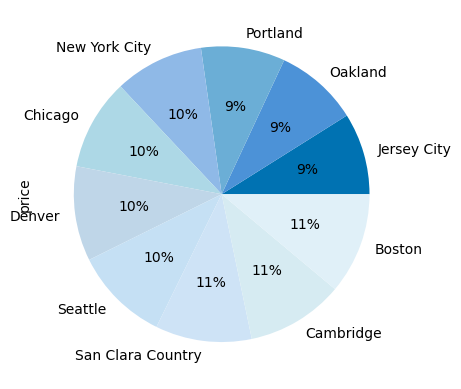

<Figure size 640x480 with 0 Axes>

In [249]:
bottom_10_cities.plot(kind="pie",autopct="%1.0f%%",shadow=False,startangle=0, colors=shades_of_blue)
plt.show()
plt.tight_layout()

## Customer Demand Summary - 2023

For the purposes of this analysis, popularity is determined by the % availability and expensive by avg. price per city 
- Analyze most popular Top 10 cities in U.S. = low mean availability (i.e., low mean indicates AirBnB was rented and NOT available) in 2023
- Analyze least popular Bottom 10 cities in U.S. = high % availability (i.e., high mean indicates AirBnB was NOT rented and therefore available) in 2023
- Analyze most expensive Top 10 cities in U.S. = top 10 cities with highest avg. prices of AirBnB per city in 2023
- Analyze least expensive Bottom 10 cities in U.S. =  bottom 10 cities with highest avg. prices of AirBnB per city in 2023


In [250]:
# Calculate the total number of unique AirBnBs grouped by City
Total_AirBnBs_2023 = AirBnB_2020_data.groupby("city").size().sort_values(ascending=False)
Total_AirBnBs_2023

city
New York City        45756
Los Angeles          31536
Hawaii               22434
San Diego            12404
Broward County       10858
Austin               10436
Clark County          8408
Washington D.C.       7350
San Clara Country     7091
San Francisco         7053
Seattle               6575
Twin Cities MSA       6470
New Orleans           6408
Chicago               6397
Nashville             6139
Portland              4281
Denver                4200
Rhode Island          3884
Boston                3339
Oakland               3204
San Mateo County      2855
Jersey City           2488
Asheville             2074
Santa Cruz County     1571
Columbus              1409
Cambridge             1029
Salem                  202
Pacific Grove          179
dtype: int64

In [251]:
map_plot_2023= AirBnB_2023_data.hvplot.points("longitude",
                                              "latitude",
                                              geo=True,
                                              tiles="OSM",
                                              frame_width=700,
                                              frame_height=400,
                                              size="availability",
                                              scale=0.4,
                                              color="city")
display(map_plot_2023)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]   (city)

In [252]:
#Calculate popularity of cities in U.S. by calculating availability per AirBnB grouped by City
popularity_2023 = AirBnB_2023_data.groupby("city")["availability_365"].mean().round(1)
popularity_2023_percent = (popularity_2023 / 365) *100

#Display Most Popular Cities (i.e., Top 10) with lowest % availability
popularity_2023.sort_values(ascending=True).head(10)


city
New York City        140.3
Austin               152.2
Rhode Island         160.8
Cambridge            167.9
San Francisco        169.8
Washington D.C.      171.6
Denver               173.0
Oakland              174.2
New Orleans          176.2
Santa Cruz County    178.6
Name: availability_365, dtype: float64

In [253]:
#Display Least Popular Cities (i.e., Bottom 10) with highest % availability
popularity_2023.sort_values(ascending=False).head(10)

city
Broward County    220.4
Columbus          208.0
Nashville         206.7
Asheville         204.5
Chicago           201.5
Los Angeles       200.0
Boston            199.5
Jersey City       197.7
Salem             195.5
Clark County      193.9
Name: availability_365, dtype: float64

In [254]:
popularity_2023_percent

city
Asheville             56.027397
Austin                41.698630
Boston                54.657534
Broward County        60.383562
Cambridge             46.000000
Chicago               55.205479
Clark County          53.123288
Columbus              56.986301
Denver                47.397260
Jersey City           54.164384
Los Angeles           54.794521
Nashville             56.630137
New Orleans           48.273973
New York City         38.438356
Oakland               47.726027
Pacific Grove         53.068493
Portland              50.931507
Rhode Island          44.054795
Salem                 53.561644
San Diego             50.575342
San Francisco         46.520548
San Mateo County      52.958904
Santa Clara County    52.657534
Santa Cruz County     48.931507
Seattle               49.698630
Twin Cities MSA       52.739726
Washington D.C.       47.013699
Name: availability_365, dtype: float64

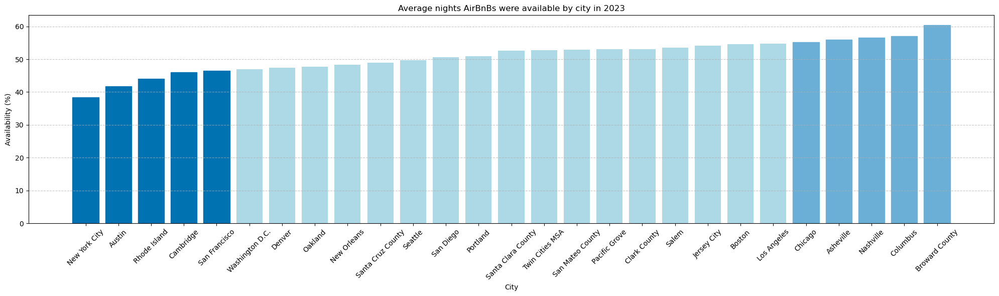

In [255]:
# Define different shades of blue for different groups
top5_blue = '#0072B2'
bottom5_blue = '#6BAED6'
other_blue = '#ADD8E6'

# Sort the data in ascending order
popularity_2023_percent = popularity_2023_percent.sort_values(ascending=True)

# Plot bar graph showing the average % availability of AirBnBs by city
plt.figure(figsize=(20, 6))
bars = plt.bar(popularity_2023_percent.index, popularity_2023_percent, color=other_blue)

# Set color for top 5 and bottom 5 cities
for i, bar in enumerate(bars):
    if i < 5:
        bar.set_color(top5_blue)
    elif i >= len(bars) - 5:
        bar.set_color(bottom5_blue)

plt.title("Average nights AirBnBs were available by city in 2023")
plt.xlabel("City")
plt.ylabel("Availability (%)")
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.yticks(range(0, 61, 10))  # Set y-axis ticks from 0 to 100 with a step of 10
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add horizontal grid lines
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

In [256]:
#Calculate avg. price per AirBnB grouped by City
average_price_per_city_2023=AirBnB_2023_data.groupby(["city"])["price"].mean().round(1)

#Display Most Expensive Cities (i.e., Top 10 highest avg. price of AirBnB)
average_price_per_city_2023.sort_values(ascending=False).head(10)

city
Clark County         441.3
Rhode Island         344.2
San Francisco        330.1
Santa Cruz County    311.9
Broward County       311.8
Austin               310.0
San Diego            309.6
Pacific Grove        289.3
Los Angeles          283.3
Nashville            281.6
Name: price, dtype: float64

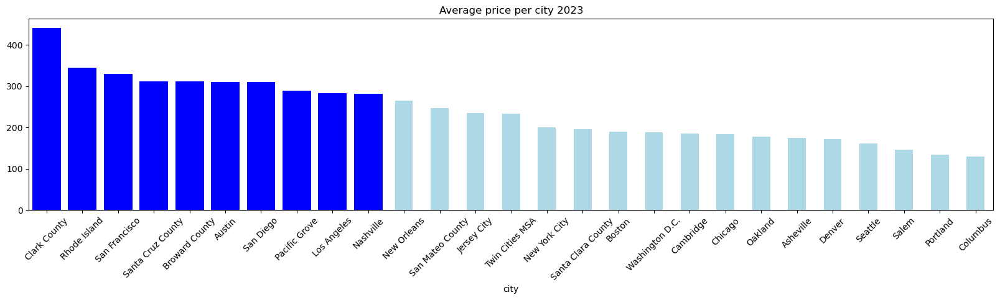

In [276]:
# Sort the data in ascending order
average_price_per_city_2023_sorted = average_price_per_city_2023.sort_values(ascending=False)

# Plot bar graph showing the average price of AirBnBs by city
plt.figure(figsize=(20, 4))
ax = average_price_per_city_2023_sorted.plot(kind="bar", color="lightblue") 
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Color the top 10 bars differently
top_10_cities = average_price_per_city_2023_sorted.nlargest(10)
for city in top_10_cities.index:
    ax.bar(city, top_10_cities[city], color="blue")  # Color the top 10 bars with blue color


plt.title("Average price per city 2023")
plt.show()

In [277]:
#Display Least Expensive Cities (i.e., Bottom 10 lowest avg. price of AirBnB)
average_price_per_city_2020.sort_values(ascending=True).head(10).round(1)

city
Jersey City          137.0
Oakland              140.0
Portland             141.0
New York City        149.6
Chicago              153.0
Denver               158.9
Seattle              159.7
San Clara Country    161.7
Cambridge            163.1
Boston               170.3
Name: price, dtype: float64

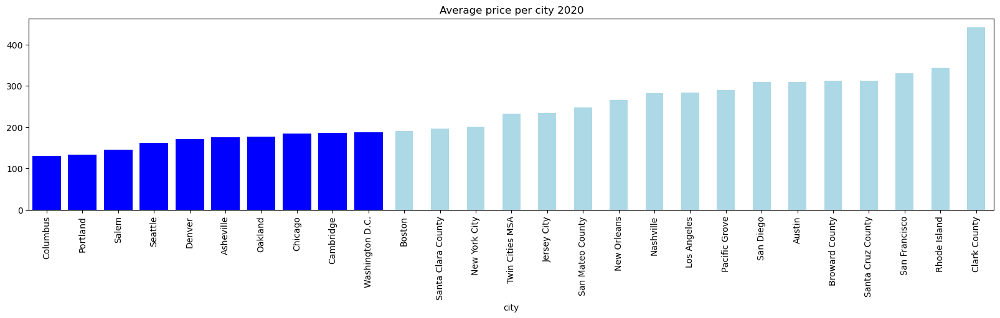

In [278]:
# Sort the data in ascending order
average_price_per_city_2023_sorted = average_price_per_city_2023.sort_values(ascending=True)

# Plot bar graph showing the average price of AirBnBs by city
plt.figure(figsize=(20, 4))
ax = average_price_per_city_2023_sorted.plot(kind="bar", color="lightblue")

# Plot bottom 10 bars separately to change their color
bottom_10_cities = average_price_per_city_2023_sorted.nsmallest(10)
for city in bottom_10_cities.index:
    plt.bar(city, bottom_10_cities[city], color="blue")

plt.title("Average price per city 2020")
plt.show()

## Understanding Customer Behavior - 2020

Customer Behavior correlations based on available data: 
- Analyze % of renters who preferred Entire Home vs. Private Room in 2020
- Analyze number of reviews compared to % availability of the AirBnB in 2020
- Analyze comparison of price vs. minimum number of nights booked in 2020
- Analyze number of reviews compared to city (i.e., which cities see most reviews which see least) in 2020
- Analyze how weather impacts AirBnB availability by city in 2020

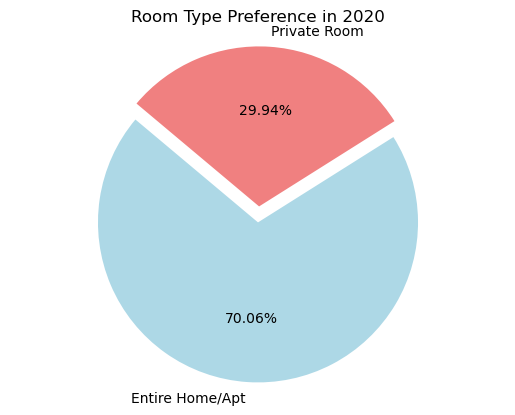

In [279]:
# Calculate % of renters who preferred Entire Home vs. Private Room in 2020
# Filter data for the year 2020
AirBnB_data_2020_home_type = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]

# Count the number of rentals for each room type
room_type_counts_2020 = AirBnB_data_2020_home_type['room_type'].value_counts()

# Calculate the percentage of renters for each room type
percentage_entire_home_2020 = (room_type_counts_2020['Entire home/apt'] / len(AirBnB_data_2020_home_type)) * 100
percentage_private_room_2020 = (room_type_counts_2020['Private room'] / len(AirBnB_data_2020_home_type)) * 100

#Display as pie chart
labels = ['Entire Home/Apt', 'Private Room']
sizes = [percentage_entire_home_2020, percentage_private_room_2020]
colors = ['lightblue', 'lightcoral']
explode = (0.1, 0)  # explode the 1st slice (Entire Home/Apt)
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%0.2f%%', shadow=False, startangle=140)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Room Type Preference in 2020')
plt.show()

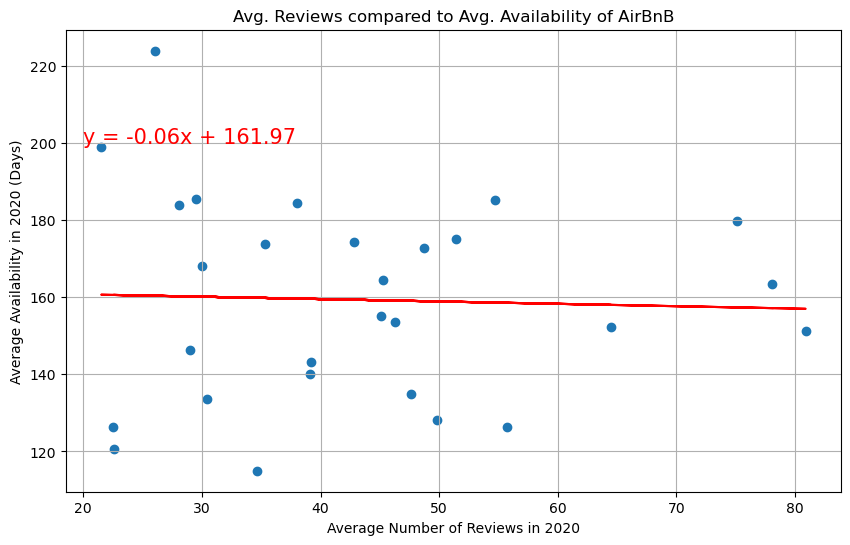

The correlation between both factors is -0.04


In [280]:
# Group the data by city and calculate the average number of reviews
avg_reviews_2020_data = AirBnB_2020_data.groupby("city")["number_of_reviews"].mean().round(1)

# Group the data by city and calculate the average availability
popularity_2020_data = AirBnB_2020_data.groupby("city")["availability_365"].mean().round(1)

# Convert data to DataFrame
avg_reviews_2020_df = pd.DataFrame(avg_reviews_2020_data)
popularity_2020_df = pd.DataFrame(popularity_2020_data)

# Merge both DataFrames on city column
merged_data = pd.merge(avg_reviews_2020_df, popularity_2020_df, on='city')

# Plot the different factors in a scatter plot
x_values = merged_data['number_of_reviews']
y_values = merged_data['availability_365']

# Calculate linear regression
(slope, intercept, rvalue, pvalue, stderr) = st.linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope, 2)) + "x + " + str(round(intercept, 2))

# Plot scatterplot with linear regression
plt.figure(figsize=(10, 6))
plt.scatter(x_values, y_values)
plt.plot(x_values, regress_values, "r-")
plt.annotate(line_eq, (20, 200), fontsize=15, color="red")
plt.title('Avg. Reviews compared to Avg. Availability of AirBnB')
plt.xlabel('Average Number of Reviews in 2020')
plt.ylabel('Average Availability in 2020 (Days)')
plt.grid(True)
plt.show()

# Calculate Pearson correlation coefficient
corr, _ = st.pearsonr(x_values, y_values)

# Print correlation coefficient
print(f"The correlation between both factors is {round(corr, 2)}")


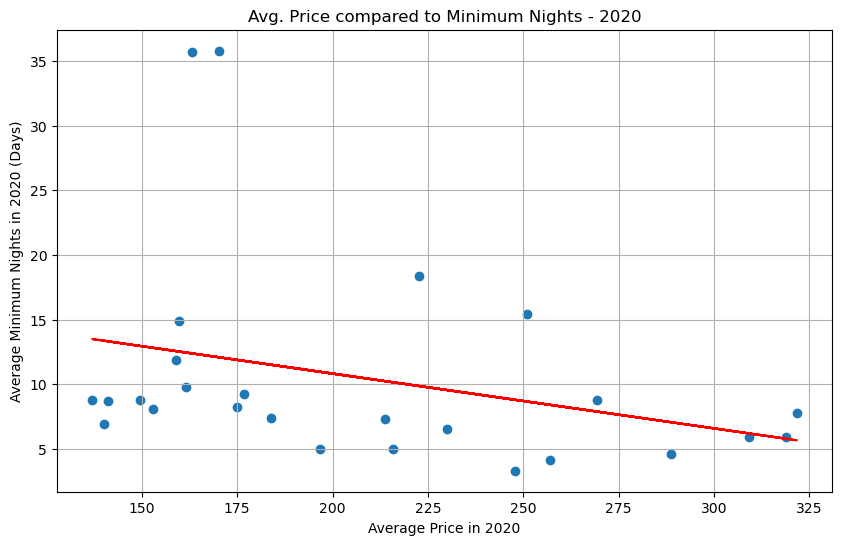

The correlation between both factors (without outliers) is -0.3


In [328]:
# Create comparison of price vs. minimum number of nights booked in 2020
# Group the data by city and calculate the average price
avg_price_2020_data = AirBnB_2020_data.groupby("city")["price"].mean().round(1)

# Group the data by city and calculate the average minimum number of nights booked
avg_nights_2020_data = AirBnB_2020_data.groupby("city")["minimum_nights"].mean().round(1)

# Convert data to DataFrame
avg_price_2020_df = pd.DataFrame(avg_price_2020_data)
avg_nights_2020_df = pd.DataFrame(avg_nights_2020_data)

# Merge both DataFrames on city column
merged_data_2 = pd.merge(avg_price_2020_df, avg_nights_2020_df, on='city')

# Plot the different factors in a scatter plot
x_values = merged_data_2['price']
y_values = merged_data_2['minimum_nights']

# Define a function to remove outliers based on z-score
def remove_outliers(df, columns, threshold=3):
    from scipy.stats import zscore
    return df[(abs(zscore(df[columns])) < threshold).all(axis=1)]

# Remove outliers from merged_data_2 based on z-score for both price and minimum nights
merged_data_2_no_outlier = remove_outliers(merged_data_2, ['price', 'minimum_nights'])

# Plot the different factors in a scatter plot without outliers
x_values_no_outlier = merged_data_2_no_outlier['price']
y_values_no_outlier = merged_data_2_no_outlier['minimum_nights']

# Calculate linear regression without outliers
(slope_no_outlier, intercept_no_outlier, rvalue_no_outlier, pvalue_no_outlier, stderr_no_outlier) = st.linregress(x_values_no_outlier, y_values_no_outlier)
regress_values_no_outlier = x_values_no_outlier * slope_no_outlier + intercept_no_outlier
line_eq_no_outlier = "y = " + str(round(slope_no_outlier, 2)) + "x + " + str(round(intercept_no_outlier, 2))

# Plot scatterplot with linear regression without outliers
plt.figure(figsize=(10, 6))
plt.scatter(x_values_no_outlier, y_values_no_outlier)
plt.plot(x_values_no_outlier, regress_values_no_outlier, "r-")
plt.annotate(line_eq_no_outlier, (20, 200), fontsize=15, color="red")
plt.title('Avg. Price compared to Minimum Nights - 2020')
plt.xlabel('Average Price in 2020')
plt.ylabel('Average Minimum Nights in 2020 (Days)')
plt.grid(True)
plt.show()

# Calculate Pearson correlation coefficient without outliers
corr_no_outlier, _ = st.pearsonr(x_values_no_outlier, y_values_no_outlier)

# Print correlation coefficient without outliers
print(f"The correlation between both factors (without outliers) is {round(corr_no_outlier, 2)}")

## Understanding Customer Behavior - 2023

Customer Behavior correlations based on available data: 
- Analyze % of renters who preferred Entire Home vs. Private Room in 2023
- Analyze number of reviews compared to % availability of the AirBnB in 2023
- Analyze comparison of price vs. minimum number of nights booked in 2023
- Analyze number of reviews compared to city (i.e., which cities see most reviews which see least) in 2023
- Analyze how weather impacts AirBnB availability by city in 2023

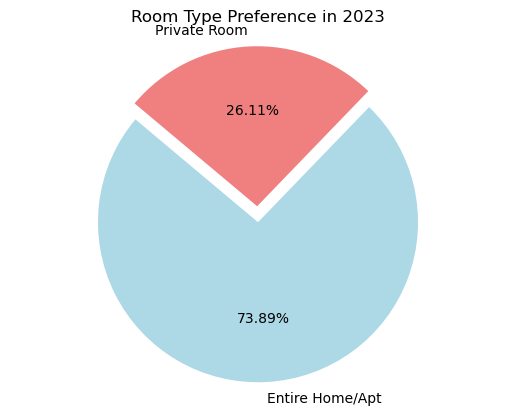

In [329]:
# Calculate % of renters who preferred Entire Home vs. Private Room in 2023
# Filter data for the year 2020
AirBnB_data_2023_home_type = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]

# Count the number of rentals for each room type
room_type_counts_2023 = AirBnB_data_2023_home_type['room_type'].value_counts()

# Calculate the percentage of renters for each room type
percentage_entire_home_2023 = (room_type_counts_2023['Entire home/apt'] / len(AirBnB_data_2023_home_type)) * 100
percentage_private_room_2023 = (room_type_counts_2023['Private room'] / len(AirBnB_data_2023_home_type)) * 100

#Display as pie chart
labels = ['Entire Home/Apt', 'Private Room']
sizes = [percentage_entire_home_2023, percentage_private_room_2023]
colors = ['lightblue', 'lightcoral']
explode = (0.1, 0)  # explode the 1st slice (Entire Home/Apt)
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%0.2f%%', shadow=False, startangle=140)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Room Type Preference in 2023')
plt.show()

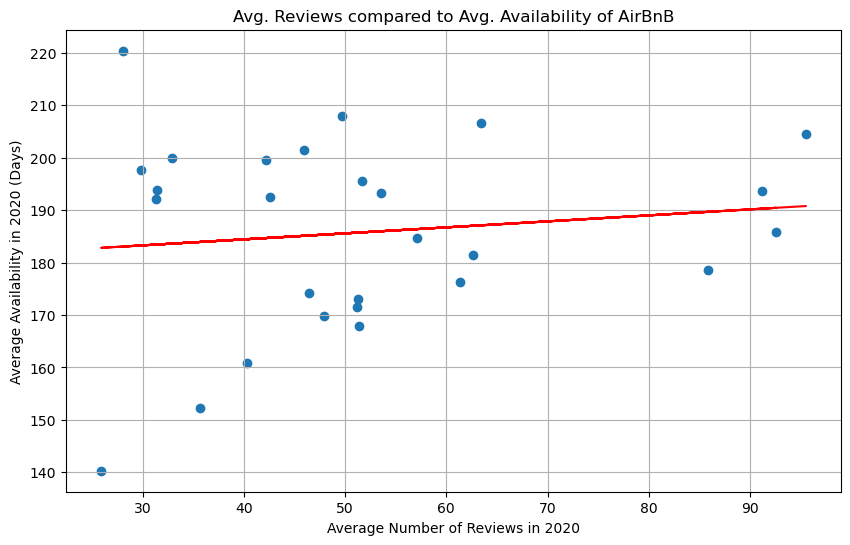

The correlation between both factors is 0.12


In [330]:
# Group the data by city and calculate the average number of reviews
avg_reviews_2023_data = AirBnB_2023_data.groupby("city")["number_of_reviews"].mean().round(1)

# Group the data by city and calculate the average availability
popularity_2023_data = AirBnB_2023_data.groupby("city")["availability_365"].mean().round(1)

# Convert data to DataFrame
avg_reviews_2023_df = pd.DataFrame(avg_reviews_2023_data)
popularity_2023_df = pd.DataFrame(popularity_2023_data)

# Merge both DataFrames on city column
merged_data_3 = pd.merge(avg_reviews_2023_df, popularity_2023_df, on='city')

# Plot the different factors in a scatter plot
x_values = merged_data_3['number_of_reviews']
y_values = merged_data_3['availability_365']

# Calculate linear regression
(slope, intercept, rvalue, pvalue, stderr) = st.linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope, 2)) + "x + " + str(round(intercept, 2))

# Plot scatterplot with linear regression
plt.figure(figsize=(10, 6))
plt.scatter(x_values, y_values)
plt.plot(x_values, regress_values, "r-")
plt.annotate(line_eq, (20, 200), fontsize=15, color="red")
plt.title('Avg. Reviews compared to Avg. Availability of AirBnB')
plt.xlabel('Average Number of Reviews in 2020')
plt.ylabel('Average Availability in 2020 (Days)')
plt.grid(True)
plt.show()

# Calculate Pearson correlation coefficient
corr_3, _ = st.pearsonr(x_values, y_values)

# Print correlation coefficient
print(f"The correlation between both factors is {round(corr_3, 2)}")


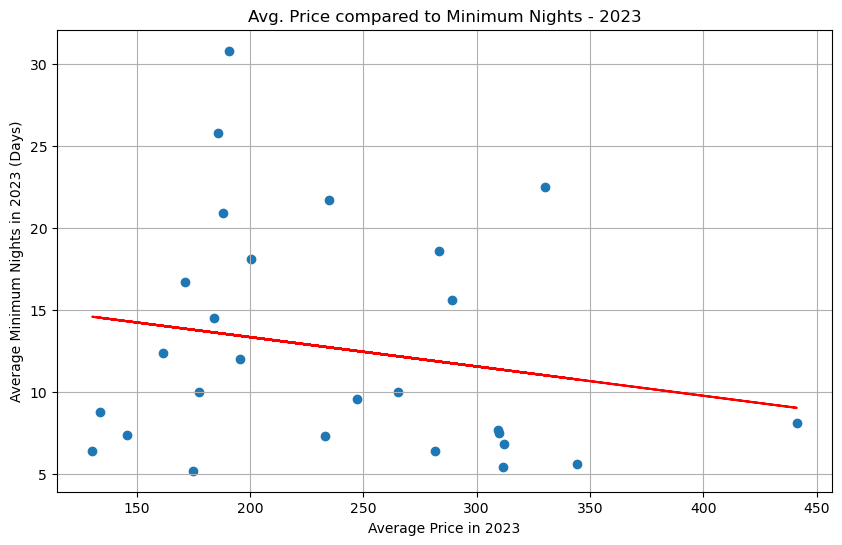

The correlation between both factors (without outliers) is -0.3


In [331]:
# Create comparison of price vs. minimum number of nights booked in 2023
# Group the data by city and calculate the average price
avg_price_2023_data = AirBnB_2023_data.groupby("city")["price"].mean().round(1)

# Group the data by city and calculate the average minimum number of nights booked
avg_nights_2023_data = AirBnB_2023_data.groupby("city")["minimum_nights"].mean().round(1)

# Convert data to DataFrame
avg_price_2023_df = pd.DataFrame(avg_price_2023_data)
avg_nights_2023_df = pd.DataFrame(avg_nights_2023_data)

# Merge both DataFrames on city column
merged_data_4 = pd.merge(avg_price_2023_df, avg_nights_2023_df, on='city')

# Plot the different factors in a scatter plot
x_values = merged_data_4['price']
y_values = merged_data_4['minimum_nights']

# Define a function to remove outliers based on z-score
def remove_outliers(df, columns, threshold=3):
    from scipy.stats import zscore
    return df[(abs(zscore(df[columns])) < threshold).all(axis=1)]

# Remove outliers from merged_data_2 based on z-score for both price and minimum nights
merged_data_4_no_outlier = remove_outliers(merged_data_4, ['price', 'minimum_nights'])

# Plot the different factors in a scatter plot without outliers
x_values_no_outlier_2 = merged_data_4_no_outlier['price']
y_values_no_outlier_2 = merged_data_4_no_outlier['minimum_nights']

# Calculate linear regression without outliers
(slope_no_outlier_2, intercept_no_outlier_2, rvalue_no_outlier_2, pvalue_no_outlier_2, stderr_no_outlier) = st.linregress(x_values_no_outlier_2, y_values_no_outlier_2)
regress_values_no_outlier_2 = x_values_no_outlier_2 * slope_no_outlier_2 + intercept_no_outlier_2
line_eq_no_outlier_2 = "y = " + str(round(slope_no_outlier_2, 2)) + "x + " + str(round(intercept_no_outlier_2, 2))

# Plot scatterplot with linear regression without outliers
plt.figure(figsize=(10, 6))
plt.scatter(x_values_no_outlier_2, y_values_no_outlier_2)
plt.plot(x_values_no_outlier_2, regress_values_no_outlier_2, "r-")
plt.annotate(line_eq_no_outlier_2, (20, 200), fontsize=15, color="red")
plt.title('Avg. Price compared to Minimum Nights - 2023')
plt.xlabel('Average Price in 2023')
plt.ylabel('Average Minimum Nights in 2023 (Days)')
plt.grid(True)
plt.show()

# Calculate Pearson correlation coefficient without outliers
corr_no_outlier_2, _ = st.pearsonr(x_values_no_outlier, y_values_no_outlier)

# Print correlation coefficient without outliers
print(f"The correlation between both factors (without outliers) is {round(corr_no_outlier_2, 2)}")

## Comparing AirBnB rentals in 2020 and 2023

- Compare 2020 to 2023 number of rentals
- Compare 2020 to 2023 price of rentals
- Compare 2020 to 2023 reviews of rentals
- Compare 2020 to 2023 % of availability 
- Compare 2020 to 2023 avg. minimum number of nights booked

In [332]:
# Compare 2020 to 2023 total number of rentals
# Sum the number of rentals for 2020
total_rentals_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]['id'].count()

# Sum the number of rentals for 2023
total_rentals_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]['id'].count()

# Display the total number of rentals for each year
print("Total number of rentals in 2020:", total_rentals_2020)
print("Total number of rentals in 2023:", total_rentals_2023)

# Calculate the percent change in total number of rentals between 2020 and 2023
percent_change_total_rentals = ((total_rentals_2023 - total_rentals_2020) / total_rentals_2023) * 100

# Display the percent change formatted as a percentage
print("Percent change in total number of rentals between 2020 and 2023: {:.2f}%".format(percent_change_total_rentals))

Total number of rentals in 2020: 226030
Total number of rentals in 2023: 232147
Percent change in total number of rentals between 2020 and 2023: 2.63%


In [333]:
# Compare 2020 to 2023 avg. price of rentals
# Average price of rentals for 2020
avg_price_rentals_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]['price'].mean().round(1)

# Average price of rentals for 2023
avg_price_rentals_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]['price'].mean().round(1)

# Display average price of rentals for each year
print("Average price of rentals in 2020:", avg_price_rentals_2020)
print("Average price of rentals in 2023:", avg_price_rentals_2023)

# Calculate the percent change in average price of rentals between 2020 and 2023
percent_change_avg_price = ((avg_price_rentals_2023 - avg_price_rentals_2020) / avg_price_rentals_2023) * 100

# Display the percent change formatted as a percentage
print("Percent change in average price of rentals between 2020 and 2023: {:.2f}%".format(percent_change_avg_price))

Average price of rentals in 2020: 219.7
Average price of rentals in 2023: 259.5
Percent change in average price of rentals between 2020 and 2023: 15.34%


In [334]:
# Compare 2020 to 2023 avg. number of reviews of rentals
# Average number of reviews of rentals for 2020
avg_reviews_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]['number_of_reviews'].mean().round(1)

# Average number of reviews of rentals for 2023
avg_reviews_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]['number_of_reviews'].mean().round(1)

# Display average number of reviews of rentals for each year
print("Average number of reviews of rentals in 2020:", avg_reviews_2020)
print("Average number of reviews of rentals in 2023:", avg_reviews_2023)

# Calculate the percent change in average number of reviews of rentals between 2020 and 2023
percent_change_avg_reviews = ((avg_reviews_2023 - avg_reviews_2020) / avg_reviews_2023) * 100

# Display the percent change formatted as a percentage
print("Percent change in average number of reviews of rentals between 2020 and 2023: {:.2f}%".format(percent_change_avg_reviews))

Average number of reviews of rentals in 2020: 34.5
Average number of reviews of rentals in 2023: 40.9
Percent change in average number of reviews of rentals between 2020 and 2023: 15.65%


In [335]:
# Compare 2020 to 2023 mean of availability for rentals
# Average nights of availability for AirBnB rentals in 2020
avg_availability_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]['availability_365'].mean().round(1)

# Average nights of availability for AirBnB rentals in 2023
avg_availability_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]['availability_365'].mean().round(1)

# Display the average nights of availability for AirBnB rentals for each year
print("Average nights of availability for AirBnB rentals in 2020:", avg_availability_2020)
print("Average nights of availability for AirBnB rentals in 2023:", avg_availability_2023)

# Calculate the difference in the average nights of availability for AirBnB rentals between 2020 and 2023
percent_change_avg_availability = ((avg_availability_2023 - avg_availability_2020) / avg_availability_2023) * 100

# Display the percent change formatted as a percentage
print("Percent change in the average nights of availability between 2020 and 2023: {:.2f}%".format(percent_change_avg_availability))

Average nights of availability for AirBnB rentals in 2020: 159.3
Average nights of availability for AirBnB rentals in 2023: 181.0
Percent change in the average nights of availability between 2020 and 2023: 11.99%


In [336]:
# Compare 2020 to 2023 avg. minimum number of nights booked
# Average minimum number of nights booked for AirBnB rentals in 2020
avg_minimum_night_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020]['minimum_nights'].median()

# Average minimum number of nights booked for AirBnB rentals in 2023
avg_minimum_night_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023]['minimum_nights'].median()

# Display the average minimum number of nights booked for each year
print("Average minimum number of nights booked for AirBnB rentals in 2020:", avg_minimum_night_2020)
print("Average minimum number of nights booked for AirBnB rentals in 2023:", avg_minimum_night_2023)

# Calculate the difference in the average minimum number of nights booked between 2020 and 2023
percent_change_min_nights = ((avg_minimum_night_2023 - avg_minimum_night_2020) / avg_minimum_night_2023) * 100

# Display the percent change formatted as a percentage
print("Percent change in the average nights of availability between 2020 and 2023: {:.2f}%".format(percent_change_min_nights))

Average minimum number of nights booked for AirBnB rentals in 2020: 2.0
Average minimum number of nights booked for AirBnB rentals in 2023: 3.0
Percent change in the average nights of availability between 2020 and 2023: 33.33%


In [337]:
# Create summary table comparing 2020 to 2023 AirBnB data
# Define data set for the DataFrame
AirBnB_data_input = {
    'Metric': ['Total number of rentals', 'Average price of rentals', 'Average number of reviews of rentals',
               'Average nights of availability', 'Average minimum number of nights booked'],
    '2020': [total_rentals_2020, avg_price_rentals_2020, avg_reviews_2020, avg_availability_2020, avg_minimum_night_2020],
    '2023': [total_rentals_2023, avg_price_rentals_2023, avg_reviews_2023, avg_availability_2023, avg_minimum_night_2023],
    'Percent Change': [percent_change_total_rentals, percent_change_avg_price, percent_change_avg_reviews,
                       percent_change_avg_availability, percent_change_min_nights]
}

# Create DataFrame
summary_table = pd.DataFrame(AirBnB_data_input)

# Format percent change & total number of rentals columns
summary_table['Percent Change'] = summary_table['Percent Change'].map('{:.2f}%'.format)
summary_table.loc[summary_table['Metric'] == 'Total number of rentals', ['2020', '2023']] = summary_table.loc[summary_table['Metric'] == 'Total number of rentals', ['2020', '2023']].applymap('{:,.1f}'.format)

# Set Metric column as index
summary_table.set_index('Metric', inplace=True)

# Display the summary table
print(summary_table)

                                              2020       2023 Percent Change
Metric                                                                      
Total number of rentals                  226,030.0  232,147.0          2.63%
Average price of rentals                     219.7      259.5         15.34%
Average number of reviews of rentals          34.5       40.9         15.65%
Average nights of availability               159.3      181.0         11.99%
Average minimum number of nights booked        2.0        3.0         33.33%


## Comparing AirBnB rentals in 2020 and 2023 by Cities

- Compare 2020 to 2023 number of rentals, i.e., which cities saw an increase / decrease in AirBnB rental options
- Compare 2020 to 2023 price of rentals, i.e., which cities saw an increase / decrease in average prices

In [338]:
# Compare 2020 to 2023 to show which cities saw greatest increase in total # of rentals
# Sum the number of rentals by city for 2020
total_rentals_city_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020].groupby("city")['id'].count()

# Sum the number of rentals by city for 2023
total_rentals_city_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023].groupby("city")['id'].count()

# Calculate percent change of number of rentals between 2020 to 2023
percent_change_total_rentals_city = (((total_rentals_city_2023 - total_rentals_city_2020) / total_rentals_city_2020) * 100).map('{:.2f}%'.format)

# Create a DataFrame with cities as rows and years as columns
rentals_comparison_df = pd.DataFrame({'Total Rentals 2020': total_rentals_city_2020, 'Total Rentals 2023': total_rentals_city_2023, 'Percent Change': percent_change_total_rentals_city})

# Sort the DataFrame by the 'Percent Change' column in descending order
rentals_comparison_sorted = rentals_comparison_df.sort_values(by='Percent Change', ascending=False)

# Convert 'Percent Change' column to numeric values
rentals_comparison_sorted['Percent Change'] = rentals_comparison_sorted['Percent Change'].str.rstrip('%').astype(float)

# Filter out rows with "nan%" in the 'Percent Change' column
rentals_comparison_sorted_filtered = rentals_comparison_sorted[rentals_comparison_sorted['Percent Change'].notnull()]

# Sort the DataFrame by the 'Percent Change' column in descending order
rentals_comparison_sorted_filtered = rentals_comparison_sorted_filtered.sort_values(by='Percent Change', ascending=False)
rentals_comparison_sorted_filtered['Percent Change'] = rentals_comparison_sorted_filtered['Percent Change'].map('{:.2f}%'.format)

# Display the top 10 cities that saw increase in # of rentals available from 2020 to 2023
print(rentals_comparison_sorted_filtered.head(10))


                Total Rentals 2020  Total Rentals 2023 Percent Change
city                                                                 
Columbus                    1409.0              2344.0         66.36%
Clark County                8408.0             13933.0         65.71%
Broward County             10858.0             16899.0         55.64%
Asheville                   2074.0              3161.0         52.41%
Salem                        202.0               288.0         42.57%
Nashville                   6139.0              8548.0         39.24%
Austin                     10436.0             14368.0         37.68%
Los Angeles                31536.0             42451.0         34.61%
Denver                      4200.0              5362.0         27.67%
Pacific Grove                179.0               220.0         22.91%


In [339]:
# Compare 2020 to 2023 to show which cities saw greatest decrease in total # of rentals
# Sum the number of rentals by city for 2020
total_rentals_city_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020].groupby("city")['id'].count()

# Sum the number of rentals by city for 2023
total_rentals_city_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023].groupby("city")['id'].count()

# Calculate percent change of number of rentals between 2020 to 2023
percent_change_total_rentals_city = (((total_rentals_city_2023 - total_rentals_city_2020) / total_rentals_city_2020) * 100).map('{:.2f}%'.format)

# Create a DataFrame with cities as rows and years as columns
rentals_comparison_df = pd.DataFrame({'Total Rentals 2020': total_rentals_city_2020, 'Total Rentals 2023': total_rentals_city_2023, 'Percent Change': percent_change_total_rentals_city})

# Sort the DataFrame by the 'Percent Change' column in ascending order
rentals_comparison_sorted = rentals_comparison_df.sort_values(by='Percent Change', ascending=True)

# Convert 'Percent Change' column to numeric values
rentals_comparison_sorted['Percent Change'] = rentals_comparison_sorted['Percent Change'].str.rstrip('%').astype(float)

# Filter out rows with "nan%" in the 'Percent Change' column
rentals_comparison_sorted_filtered = rentals_comparison_sorted[rentals_comparison_sorted['Percent Change'].notnull()]

# Display filtered/sorted dataframe in correct format
rentals_comparison_sorted_filtered = rentals_comparison_sorted_filtered.sort_values(by='Percent Change', ascending=True)
rentals_comparison_sorted_filtered['Percent Change'] = rentals_comparison_sorted_filtered['Percent Change'].map('{:.2f}%'.format)

# Display the bottom 10 cities that saw decrease in # of rentals available from 2020 to 2023
print(rentals_comparison_sorted_filtered.head(10))


                   Total Rentals 2020  Total Rentals 2023 Percent Change
city                                                                    
Jersey City                    2488.0              1314.0        -47.19%
Twin Cities MSA                6470.0              4765.0        -26.35%
Oakland                        3204.0              2499.0        -22.00%
Washington D.C.                7350.0              6455.0        -12.18%
New York City                 45756.0             42931.0         -6.17%
Seattle                        6575.0              6376.0         -3.03%
San Francisco                  7053.0              6936.0         -1.66%
Cambridge                      1029.0              1026.0         -0.29%
San Diego                     12404.0             12871.0          3.76%
Santa Cruz County              1571.0              1639.0          4.33%


In [340]:
# Compare 2020 to 2023 price of rentals, i.e., which cities saw an increase in prices
# Average price by city for 2020
avg_price_city_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020].groupby("city")['price'].mean().round(1)

# Average price by city for 2023
avg_price_city_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023].groupby("city")['price'].mean().round(1)

# Calculate percent change AirBnB prices between 2020 to 2023
percent_change_avg_price_city = (((avg_price_city_2023 - avg_price_city_2020) / avg_price_city_2020) * 100).map('{:.2f}%'.format)

# Create a DataFrame with cities as rows and years as columns
price_comparison_df = pd.DataFrame({'Avg. Price 2020': avg_price_city_2020, 'Avg. Price 2023': avg_price_city_2023, 'Percent Change': percent_change_avg_price_city})

# Sort the DataFrame by the 'Percent Change' column in ascending order
price_comparison_sorted = price_comparison_df.sort_values(by='Percent Change', ascending=False)

# Convert 'Percent Change' column to numeric values
price_comparison_sorted['Percent Change'] = price_comparison_sorted['Percent Change'].str.rstrip('%').astype(float)

# Filter out rows with "nan%" in the 'Percent Change' column
price_comparison_sorted_filtered = price_comparison_sorted[price_comparison_sorted['Percent Change'].notnull()]

# Display filtered/sorted dataframe in correct format
price_comparison_sorted_filtered = price_comparison_sorted_filtered.sort_values(by='Percent Change', ascending=False)
price_comparison_sorted_filtered['Percent Change'] = price_comparison_sorted_filtered['Percent Change'].map('{:.2f}%'.format)

# Display the top 10 cities that saw increase in avg. price for rentals between 2020 to 2023
print(price_comparison_sorted_filtered.head(10))


                  Avg. Price 2020  Avg. Price 2023 Percent Change
city                                                             
Clark County                213.8            441.3        106.41%
Jersey City                 137.0            234.7         71.31%
New Orleans                 175.0            265.3         51.60%
Broward County              230.1            311.8         35.51%
San Mateo County            183.9            247.2         34.42%
New York City               149.6            200.3         33.89%
San Francisco               252.0            330.1         30.99%
Nashville                   215.9            281.6         30.43%
Los Angeles                 222.7            283.3         27.21%
Oakland                     140.0            177.3         26.64%


In [341]:
# Compare 2020 to 2023 price of rentals, i.e., which cities saw an increase in prices
# Average price by city for 2020
avg_price_city_2020 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2020].groupby("city")['price'].mean().round(1)

# Average price by city for 2023
avg_price_city_2023 = AirBnB_data_complete[AirBnB_data_complete['year'] == 2023].groupby("city")['price'].mean().round(1)

# Calculate percent change AirBnB prices between 2020 to 2023
percent_change_avg_price_city = (((avg_price_city_2023 - avg_price_city_2020) / avg_price_city_2020) * 100).map('{:.2f}%'.format)

# Create a DataFrame with cities as rows and years as columns
price_comparison_df = pd.DataFrame({'Avg. Price 2020': avg_price_city_2020, 'Avg. Price 2023': avg_price_city_2023, 'Percent Change': percent_change_avg_price_city})

# Sort the DataFrame by the 'Percent Change' column in ascending order
price_comparison_sorted = price_comparison_df.sort_values(by='Percent Change', ascending=True)

# Convert 'Percent Change' column to numeric values
price_comparison_sorted['Percent Change'] = price_comparison_sorted['Percent Change'].str.rstrip('%').astype(float)

# Filter out rows with "nan%" in the 'Percent Change' column
price_comparison_sorted_filtered = price_comparison_sorted[price_comparison_sorted['Percent Change'].notnull()]

# Display filtered/sorted dataframe in correct format
price_comparison_sorted_filtered = price_comparison_sorted_filtered.sort_values(by='Percent Change', ascending=True)
price_comparison_sorted_filtered['Percent Change'] = price_comparison_sorted_filtered['Percent Change'].map('{:.2f}%'.format)

# Display the top 10 cities that saw increase in avg. price for rentals between 2020 to 2023
print(price_comparison_sorted_filtered.head(10))


                 Avg. Price 2020  Avg. Price 2023 Percent Change
city                                                            
Columbus                   321.7            130.4        -59.47%
Twin Cities MSA            509.9            233.2        -54.27%
Salem                      247.7            145.9        -41.10%
Asheville                  196.6            175.0        -10.99%
Portland                   141.0            133.9         -5.04%
San Diego                  318.8            309.6         -2.89%
Seattle                    159.7            161.8          1.31%
Washington D.C.            176.8            187.9          6.28%
Denver                     158.9            171.3          7.80%
Boston                     170.3            190.6         11.92%
